# matplotlibでのプロット

# import, 読みこみ

In [1]:
import numpy as np
import cdflib
import sympy as sp
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
from matplotlib.ticker import MultipleLocator, MaxNLocator, ScalarFormatter, FormatStrFormatter
from matplotlib.dates import MinuteLocator, SecondLocator, DateFormatter
from mpl_toolkits.axes_grid1 import make_axes_locatable
from scipy.signal import medfilt
from scipy.ndimage import median_filter
from scipy.stats import zscore
from scipy.optimize import fsolve, curve_fit
from mpl_toolkits.axes_grid1 import make_axes_locatable
from scipy.optimize import OptimizeWarning
import warnings
from matplotlib.colors import BoundaryNorm, Normalize
from datetime import datetime, timedelta
import requests
import os


In [2]:
def download_file_for_month(year, month):
    # 日付フォーマットのパラメータを定義
    base_url = 'http://adrastea.gp.tohoku.ac.jp/~jupiter/data/cdf-j/'  # ファイルのベースURL
    save_path_1 = 'it_h1_hf_'
    save_path_2 = '_v01.cdf'
    
    # ベースとなる保存ディレクトリ
    base_save_dir = '/home/kinno-7010/Document/Iwai2020event/memo/data_file'
    
    # "year_month" フォルダを作成 (例: /home/kinno-7010/.../data_file/2024_09)
    save_dir = os.path.join(base_save_dir, f"{year}_{month:02d}")
    
    # 保存先ディレクトリが存在しない場合は作成
    if not os.path.exists(save_dir):
        os.makedirs(save_dir)
    
    # 月の初日と次の月の初日（1か月後の日付）を取得
    start_date = datetime(year, month, 1)
    if month == 12:
        end_date = datetime(year + 1, 1, 1)
    else:
        end_date = datetime(year, month + 1, 1)
    
    # 1日ずつの日付でファイルをダウンロード
    current_date = start_date
    while current_date < end_date:
        # 日付を文字列に変換 (例: 20240901)
        date_str = current_date.strftime('%Y%m%d')
        save_file_name = save_path_1 + date_str + save_path_2
        full_url = base_url + save_file_name
        
        # 保存先の完全なパスを作成
        save_path = os.path.join(save_dir, save_file_name)
        
        try:
            # HTTP GETリクエストを送信
            response = requests.get(full_url, stream=True)
            if response.status_code == 200:
                # ローカルにファイルを保存
                with open(save_path, 'wb') as file:
                    for chunk in response.iter_content(chunk_size=1024):
                        if chunk:  # 空のチャンクを無視
                            file.write(chunk)
                print(f"{save_path} のダウンロードが完了しました。")
            else:
                print(f"{save_path} のダウンロードに失敗しました。ステータスコード {response.status_code}")
        except Exception as e:
            print(f"{save_path} のダウンロード中にエラーが発生しました: {e}")
        
        # 次の日に進む
        current_date += timedelta(days=1)

year = int(input("year: "))
print(f'year: {year}年')
month = int(input("month: "))
print(f'month: {month}月')

download_file_for_month(year, month)

year: 2023年
month: 4月
/home/kinno-7010/Document/Iwai2020event/memo/data_file/2023_04/it_h1_hf_20230401_v01.cdf のダウンロードが完了しました。
/home/kinno-7010/Document/Iwai2020event/memo/data_file/2023_04/it_h1_hf_20230402_v01.cdf のダウンロードが完了しました。
/home/kinno-7010/Document/Iwai2020event/memo/data_file/2023_04/it_h1_hf_20230403_v01.cdf のダウンロードが完了しました。
/home/kinno-7010/Document/Iwai2020event/memo/data_file/2023_04/it_h1_hf_20230404_v01.cdf のダウンロードが完了しました。
/home/kinno-7010/Document/Iwai2020event/memo/data_file/2023_04/it_h1_hf_20230405_v01.cdf のダウンロードが完了しました。
/home/kinno-7010/Document/Iwai2020event/memo/data_file/2023_04/it_h1_hf_20230406_v01.cdf のダウンロードが完了しました。
/home/kinno-7010/Document/Iwai2020event/memo/data_file/2023_04/it_h1_hf_20230407_v01.cdf のダウンロードが完了しました。
/home/kinno-7010/Document/Iwai2020event/memo/data_file/2023_04/it_h1_hf_20230408_v01.cdf のダウンロードが完了しました。
/home/kinno-7010/Document/Iwai2020event/memo/data_file/2023_04/it_h1_hf_20230409_v01.cdf のダウンロードが完了しました。
/home/kinno-7010/Document/Iwai202

In [4]:
year = 2023
month = 4

In [14]:
print(f'year: {year}年')
print(f'month: {month}月')
date = int(input("date: "))
print(f'date: {date}日')

year_month_date = f'{year}{month:02d}{date:02d}'

# CDFファイルのパス (WSLのLinuxパス形式)
file_path_1 = f'/home/kinno-7010/Document/Iwai2020event/memo/data_file/{year}_{month:02d}/it_h1_hf_{year}{month:02d}{date:02d}_v01.cdf'


# CDFファイルを読み込み
cdf_file = cdflib.CDF(file_path_1)

# データの読み込み
epoch = cdf_file.varget('Epoch')  # 時間
frequency = cdf_file.varget('Frequency')  # 周波数
lh_data = cdf_file.varget('RH')  # パワーフラックス密度

epoch_datetime = cdflib.cdfepoch.to_datetime(epoch)

# rhoの範囲(Baumbach-Allen modelの定義域:>1.2R, 215R = 1AU)
# rho_value = np.arange(1.2, 215, 0.01)
# 太陽半径：km
R_sun = 696340

# line plotの設定
thresholds = [105, 100, 95]
colors = ['blue', 'green', 'magenta']

 # カラーバーの最小値と最大値
vmin, vmax = 85, 105
F_value = [1.0, 10.0]

# 基準時間からのタイムスタンプ変換
base_time = pd.Timestamp(f'{year}-{month:02d}-{date:02d} 00:00:00')

# CDF_EPOCHを使用して、基準時刻との差分を計算
time = pd.to_datetime(epoch_datetime)

year: 2023年
month: 4月
date: 21日


## 関数

In [4]:
############################# 関数の定義 ##################################
####### カラープロット #######
def plot_filtered_lh_data(start_frequency, end_frequency, start_time, end_time, title, time_interval, frequency_interval, window_frequency_size, threshold_noise_max, threshold_noise_min):
    # # 周波数をHzからMHzに変換
    # start_frequency = float(input("min_frequency [MHz] = ")) * 1e6
    # print("start_frequency = ", start_frequency)
    # end_frequency = float(input("MAX_frequency [MHz] = ")) * 1e6
    # print(f"end_frequency = {end_frequency}\n")

    #####################スライス#############################
    # 時間範囲でデータをスライス (datetime64型で比較)
    time_mask = (time >= np.datetime64(start_time)) & (time <= np.datetime64(end_time))
    lh_data_sliced = lh_data[time_mask, :]  # 時間でスライス
    time_sliced = time[time_mask]  # 時間もスライス

    # 周波数範囲でデータをスライス
    freq_mask = (frequency >= start_frequency) & (frequency <= end_frequency)
    lh_data_sliced = lh_data_sliced[:, freq_mask]  # 周波数でスライス
    frequency_sliced = frequency[freq_mask]  # 周波数もスライス
    frequency_sliced_mhz = frequency_sliced / 1e6  # MHzに変換

    
    filtered_lh_data = np.where(lh_data_sliced <= threshold_noise_max, lh_data_sliced, 0)  & np.where(threshold_noise_min <= lh_data_sliced, lh_data_sliced, 0)
        # 移動中央値フィルタの適用 (周波数軸に沿って)
    window_time_size = 1
    filtered_lh_data = median_filter(filtered_lh_data, size=(window_time_size, window_frequency_size))

    ##########################カラープロットの作成##################################
    fig, ax = plt.subplots(figsize=(12, 6))

    # カラーバーを図の右側に追加
    divider = make_axes_locatable(ax)
    cax = divider.append_axes("right", size="5%", pad=0.1)

    # カラープロットの設定
    extent = [mdates.date2num(time_sliced[0]), mdates.date2num(time_sliced[-1]), frequency_sliced_mhz[0], frequency_sliced_mhz[-1]]
    img = ax.imshow(filtered_lh_data.T, aspect='auto', origin='lower', extent=extent, vmin=vmin, vmax=vmax, cmap='jet')

    # カラーバーの追加
    cbar = plt.colorbar(img, cax=cax)
    cbar.set_label(r'Power Flux Density (dBW/$\rm{m^2}$/Hz)', fontsize=24)
    cbar.ax.tick_params(labelsize=18)

    # 軸ラベルとタイトル
    ax.set_xlabel('Time (UT)', fontsize=24)
    ax.set_ylabel('Frequency (MHz)', fontsize=24)
    ax.tick_params(axis='both', labelsize=18)

    ax.set_title(title, fontsize=20)

    # 時間軸のフォーマット設定
    ax.xaxis.set_major_formatter(mdates.DateFormatter('%H:%M:%S'))
    ax.set_xlim(mdates.date2num(np.datetime64(start_time)), mdates.date2num(np.datetime64(end_time)))

    # 目盛りを設定
    ax.xaxis.set_major_locator(mdates.SecondLocator(interval=time_interval))  # 60秒ごとに目盛りを追加
    y_major_locator = MultipleLocator(frequency_interval)  # 1MHzごとに目盛を追加
    ax.yaxis.set_major_locator(y_major_locator)

    # レイアウトの調整
    plt.tight_layout()
    plt.show()


def plot_single_lh_data(start_time, end_time, title, time_interval, frequency_interval, window_frequency_size, window_time_size, threshold_noise_max, threshold_noise_min):
    # 周波数をHzからMHzに変換
    start_frequency = float(input("min_frequency [MHz] = ")) * 1e6
    print("start_frequency = ", start_frequency)
    end_frequency = float(input("MAX_frequency [MHz] = ")) * 1e6
    print(f"end_frequency = {end_frequency}\n")

    #####################スライス#############################
    # 時間範囲でデータをスライス (datetime64型で比較)
    time_mask = (time >= np.datetime64(start_time)) & (time <= np.datetime64(end_time))
    lh_data_sliced = lh_data[time_mask, :]  # 時間でスライス
    time_sliced = time[time_mask]  # 時間もスライス

    # 周波数範囲でデータをスライス
    freq_mask = (frequency >= start_frequency) & (frequency <= end_frequency)
    lh_data_sliced = lh_data_sliced[:, freq_mask]  # 周波数でスライス
    frequency_sliced = frequency[freq_mask]  # 周波数もスライス
    frequency_sliced_mhz = frequency_sliced / 1e6  # MHzに変換

    
    filtered_lh_data = np.where(lh_data_sliced <= threshold_noise_max, lh_data_sliced, 0)  & np.where(threshold_noise_min <= lh_data_sliced, lh_data_sliced, 0)
        # 移動中央値フィルタの適用 (周波数軸に沿って)
    
    filtered_lh_data = median_filter(filtered_lh_data, size=(window_time_size, window_frequency_size))
    ##########################カラープロットの作成##################################
    fig, ax = plt.subplots(figsize=(12, 6))

    # カラーバーを図の右側に追加
    divider = make_axes_locatable(ax)
    cax = divider.append_axes("right", size="5%", pad=0.1)

    # カラープロットの設定
    extent = [mdates.date2num(time_sliced[0]), mdates.date2num(time_sliced[-1]), frequency_sliced_mhz[0], frequency_sliced_mhz[-1]]
    img = ax.imshow(filtered_lh_data.T, aspect='auto', origin='lower', extent=extent, vmin=vmin, vmax=vmax, cmap='jet')

    # カラーバーの追加
    cbar = plt.colorbar(img, cax=cax)
    cbar.set_label(r'Power Flux Density (dBW/$\rm{m^2}$/Hz)', fontsize=24)
    cbar.ax.tick_params(labelsize=18)

    # 軸ラベルとタイトル
    ax.set_xlabel('Time (UT)', fontsize=24)
    ax.set_ylabel('Frequency (MHz)', fontsize=24)
    ax.tick_params(axis='both', labelsize=18)

    ax.set_title(title, fontsize=20)

    # 時間軸のフォーマット設定
    ax.xaxis.set_major_formatter(mdates.DateFormatter('%H:%M:%S'))
    ax.set_xlim(mdates.date2num(np.datetime64(start_time)), mdates.date2num(np.datetime64(end_time)))

    # 目盛りを設定
    ax.xaxis.set_major_locator(mdates.SecondLocator(interval=time_interval))  # 60秒ごとに目盛りを追加
    y_major_locator = MultipleLocator(frequency_interval)  # 1MHzごとに目盛を追加
    ax.yaxis.set_major_locator(y_major_locator)

    # レイアウトの調整
    plt.tight_layout()
    plt.show()

def plot_all_day(date, time_interval, frequency_interval, div_hour, window_frequency_size, threshold_noise_max, threshold_noise_min):
        # # 周波数をHzからMHzに変換
    start_frequency = 0 * 1e6
    print("start_frequency = ", start_frequency)
    end_frequency = 43 * 1e6
    print(f"end_frequency = {end_frequency}\n")
    
    div_num = int(24 / div_hour) # 24時間を3時間ごとに分割=プロットの数
    
    for i in range(div_num):
        # 時間の設定をnp.timedelta64ではなくpd.Timestampで行う
        start_time = pd.Timestamp(date) + pd.Timedelta(hours=div_hour*i)
        end_time = pd.Timestamp(date) + pd.Timedelta(hours=div_hour*(i+1)-1, minutes=59, seconds=59)

        # 時間を "時:分:秒" 形式にフォーマットして表示
        start_time_str = start_time.strftime('%H:%M:%S')
        end_time_str = end_time.strftime('%H:%M:%S')

        print(f'◎{start_time_str} - {end_time_str}')

        # タイトルの作成
        title = f'{date} {start_time_str} - {end_time_str}'

        # グラフ描画の関数呼び出し
        plot_filtered_lh_data(start_frequency, end_frequency, start_time, end_time, title, time_interval, frequency_interval, window_frequency_size, threshold_noise_max, threshold_noise_min)
        print('\n')




# plot

start_frequency =  0.0
end_frequency = 43000000.0

◎00:00:00 - 00:59:59


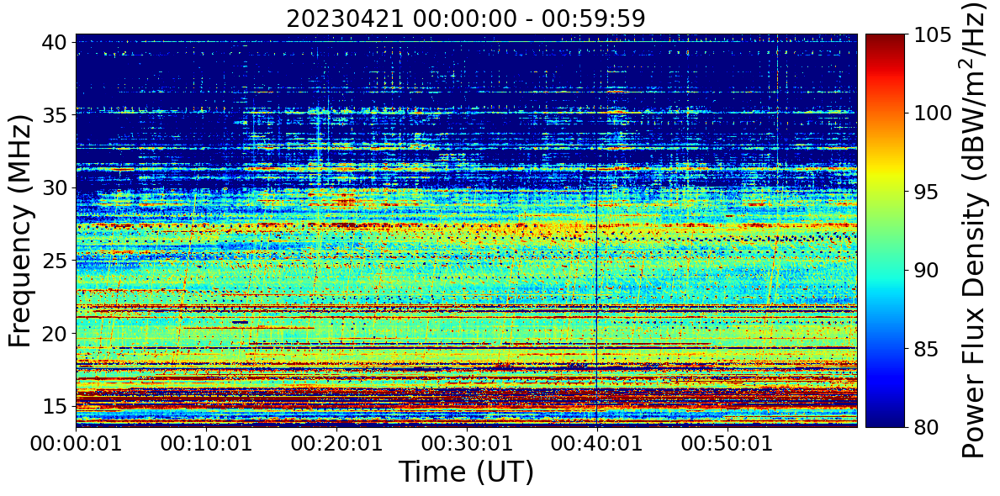



◎01:00:00 - 01:59:59


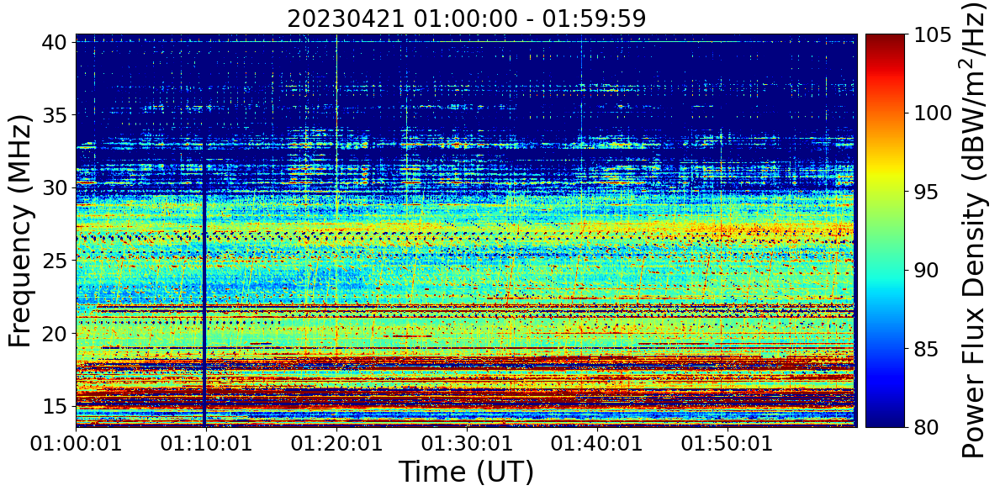



◎02:00:00 - 02:59:59


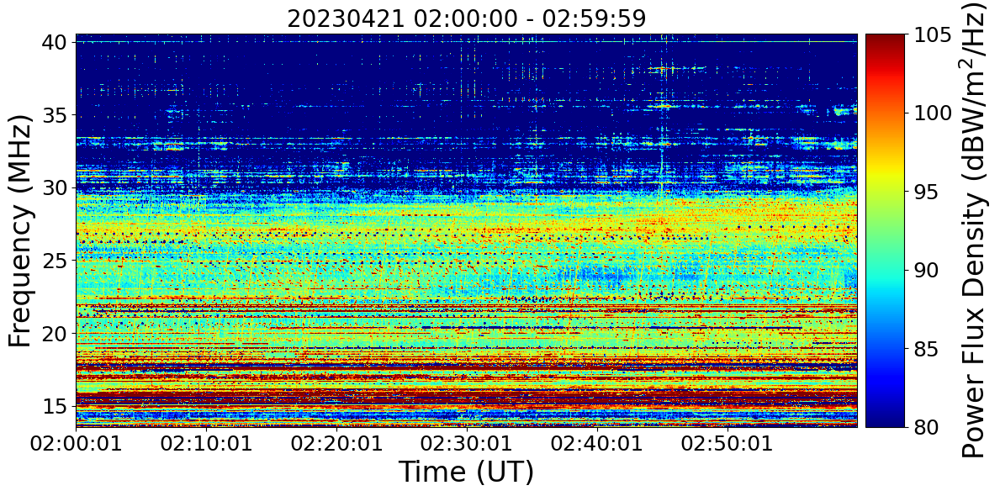



◎03:00:00 - 03:59:59


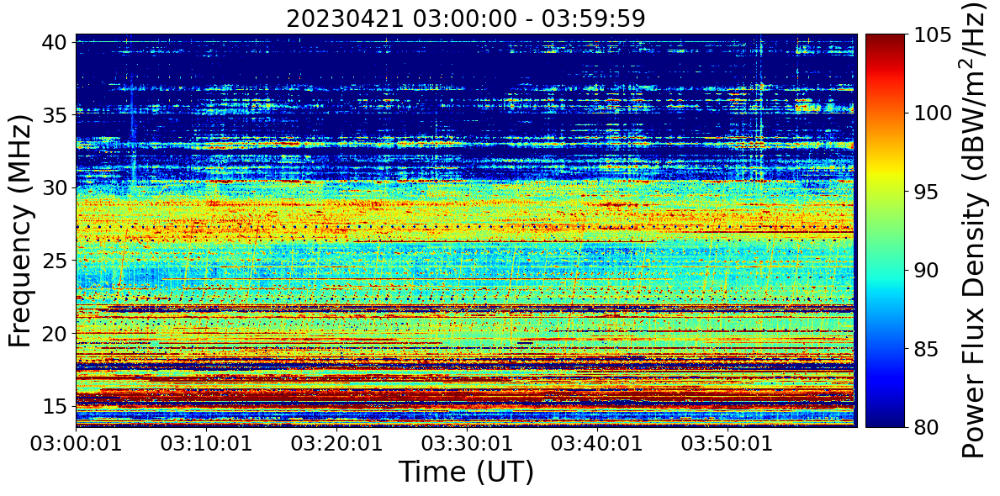



◎04:00:00 - 04:59:59


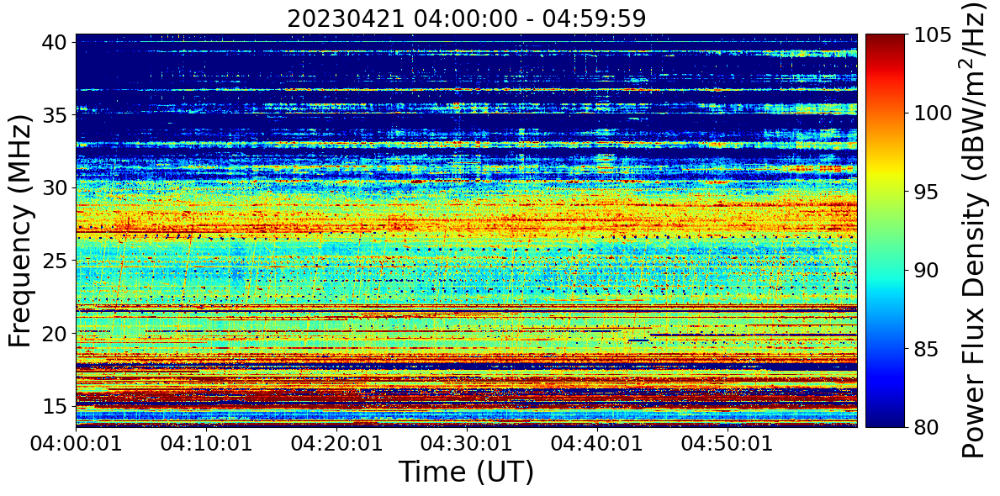



◎05:00:00 - 05:59:59


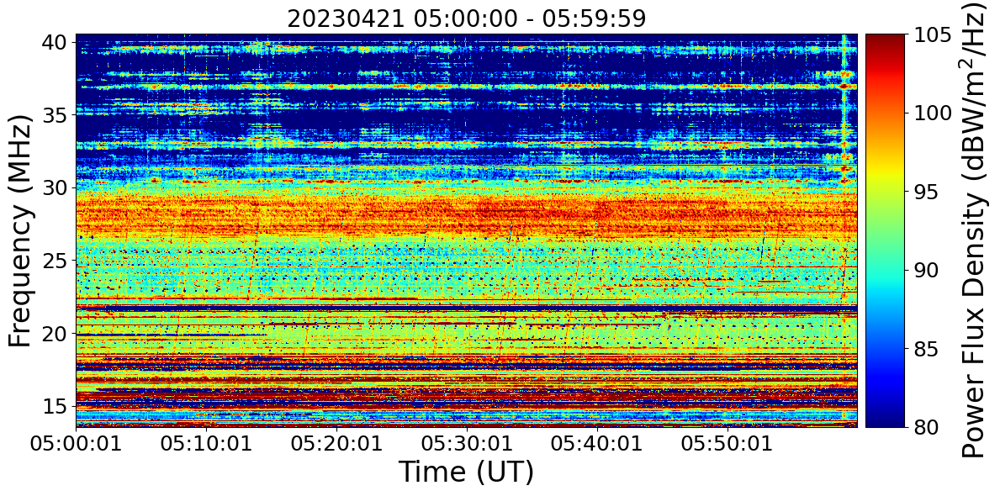



◎06:00:00 - 06:59:59


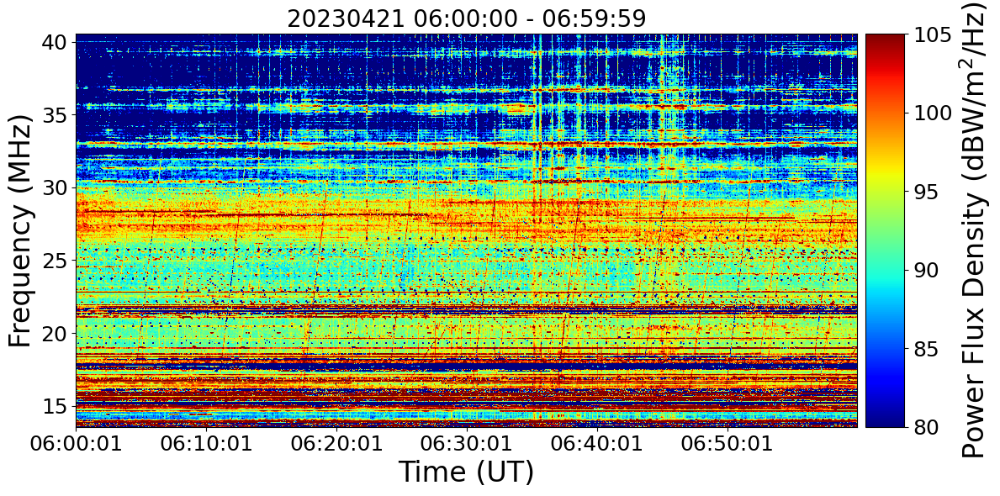



◎07:00:00 - 07:59:59


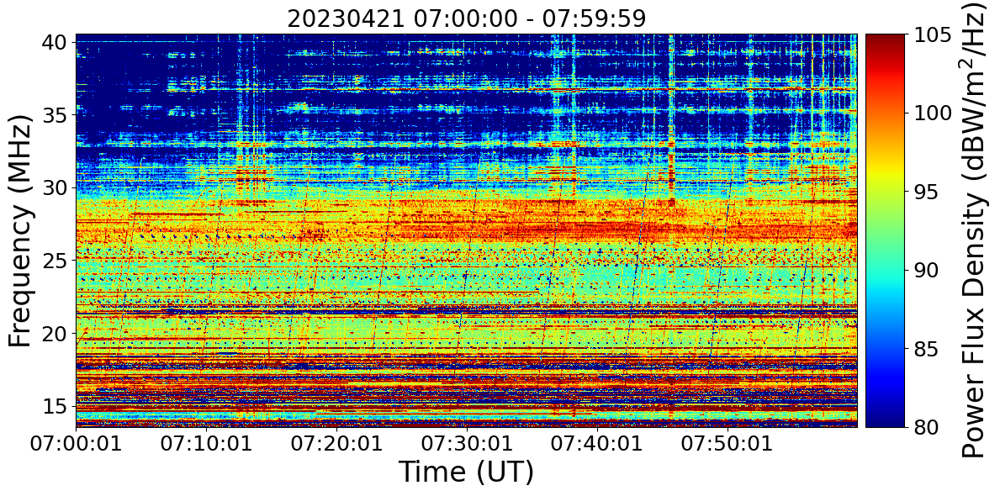



◎08:00:00 - 08:59:59


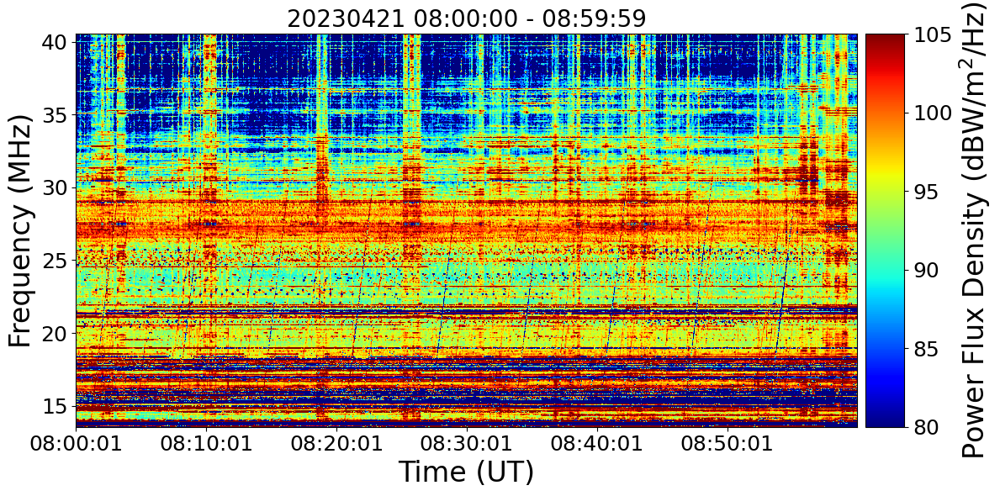



◎09:00:00 - 09:59:59


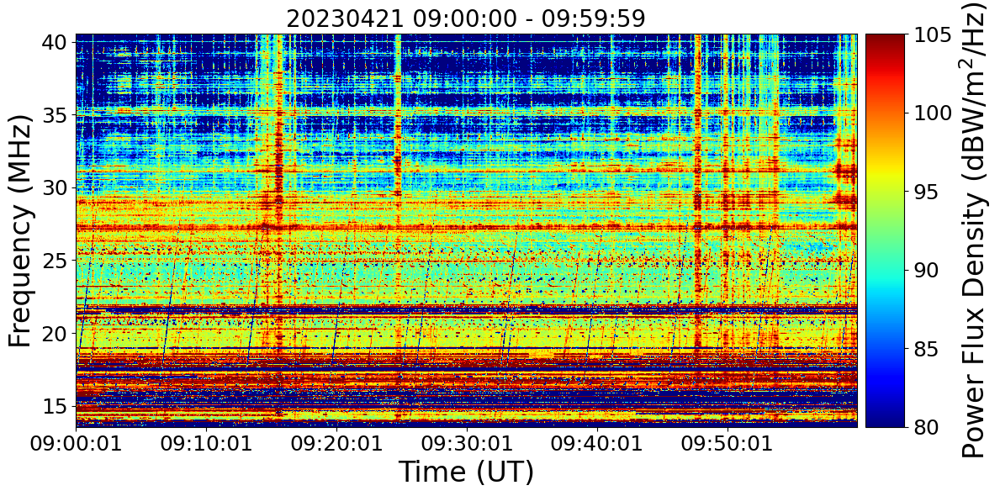



◎10:00:00 - 10:59:59


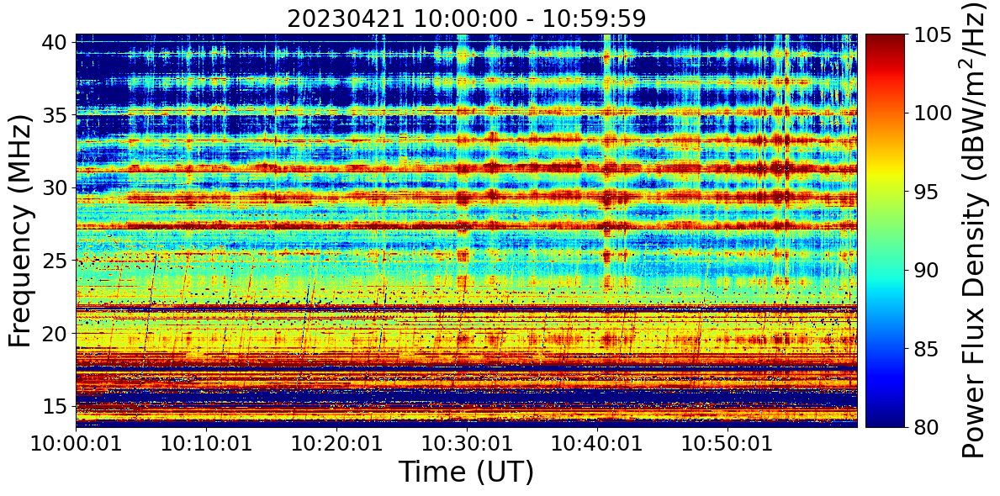



◎11:00:00 - 11:59:59


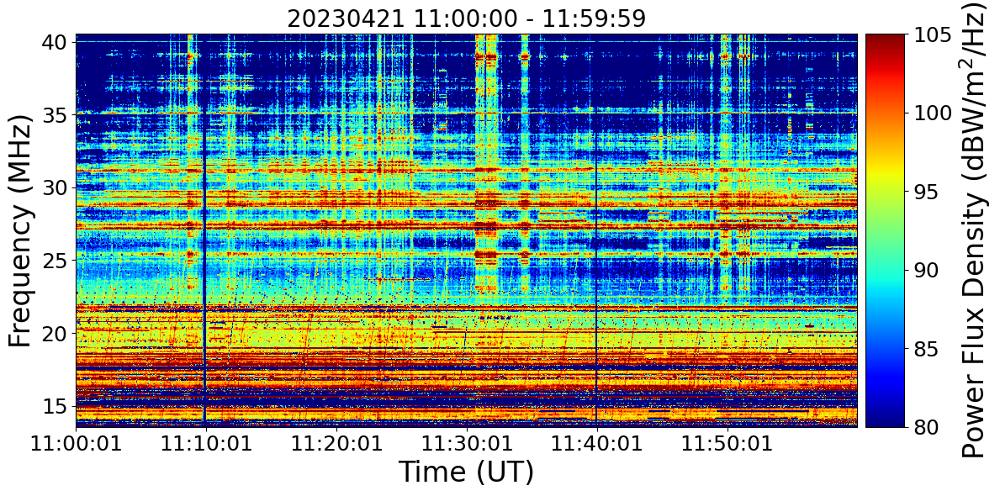



◎12:00:00 - 12:59:59


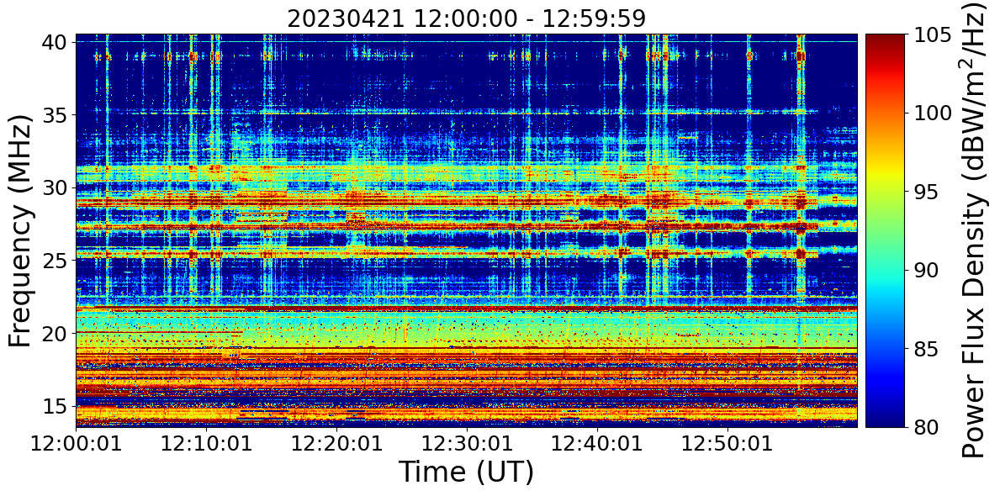



◎13:00:00 - 13:59:59


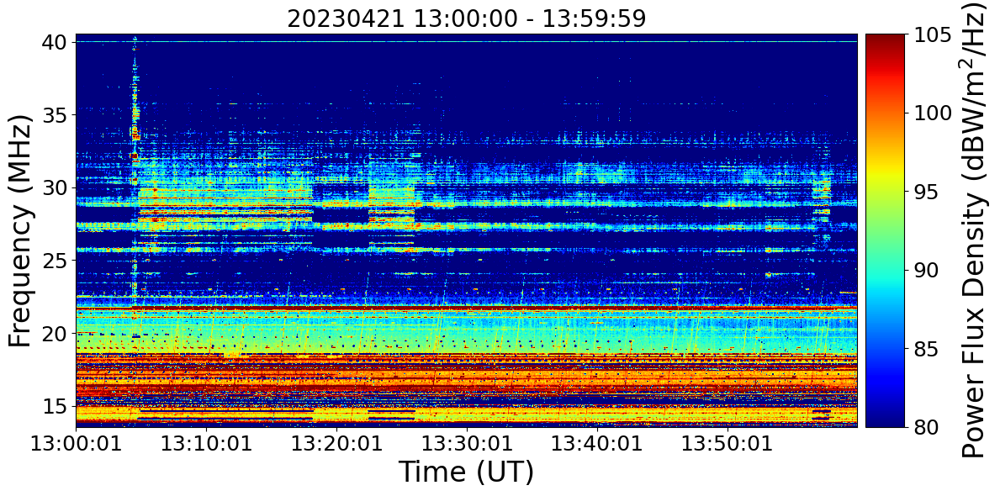



◎14:00:00 - 14:59:59


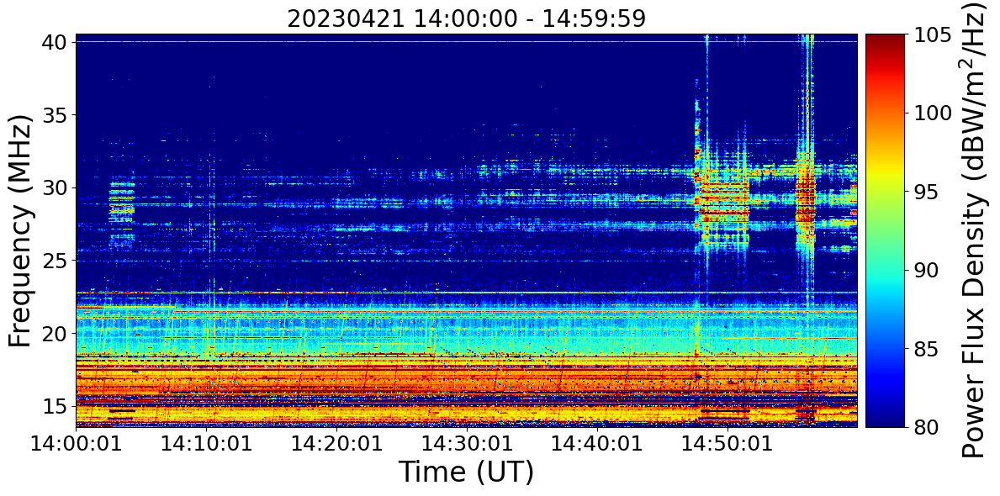



◎15:00:00 - 15:59:59


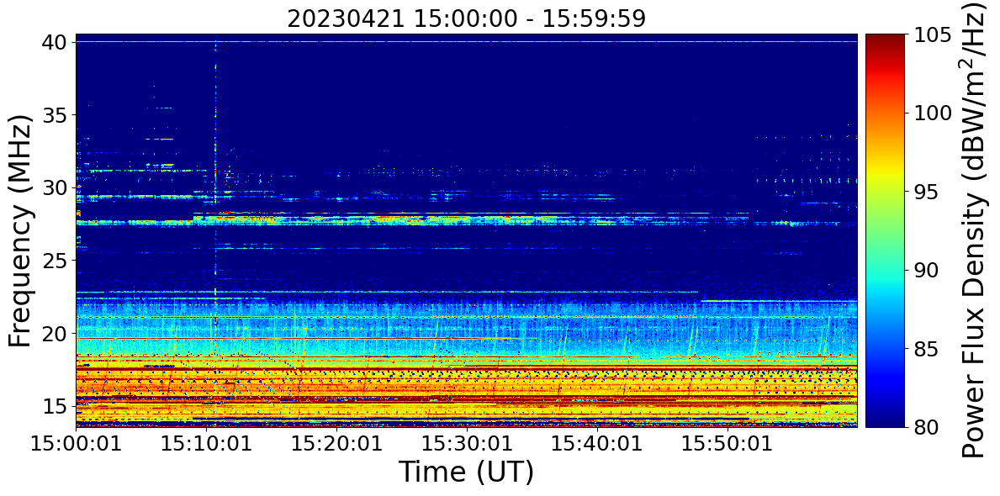



◎16:00:00 - 16:59:59


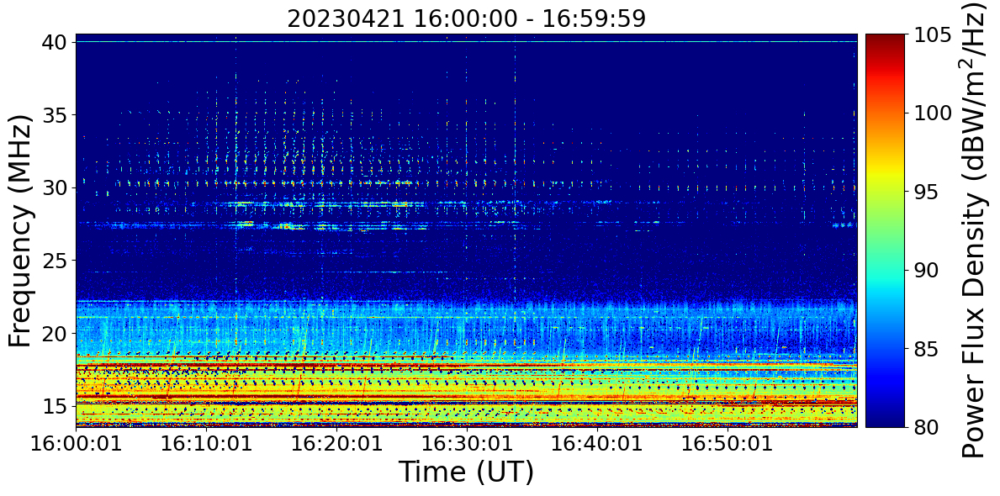



◎17:00:00 - 17:59:59


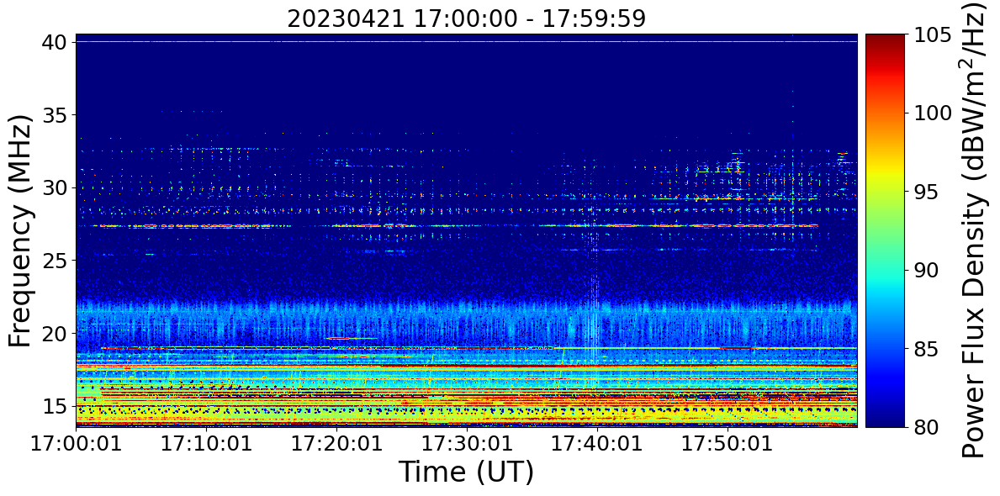



◎18:00:00 - 18:59:59


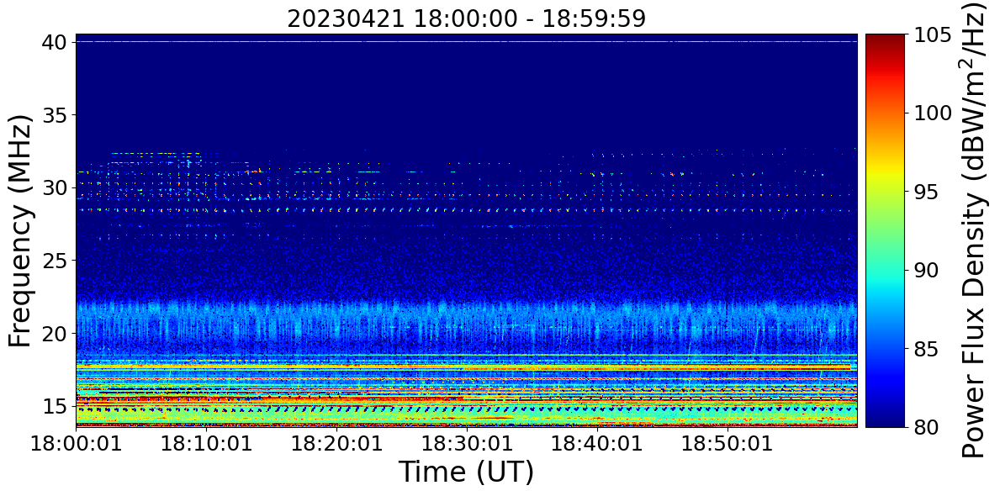



◎19:00:00 - 19:59:59


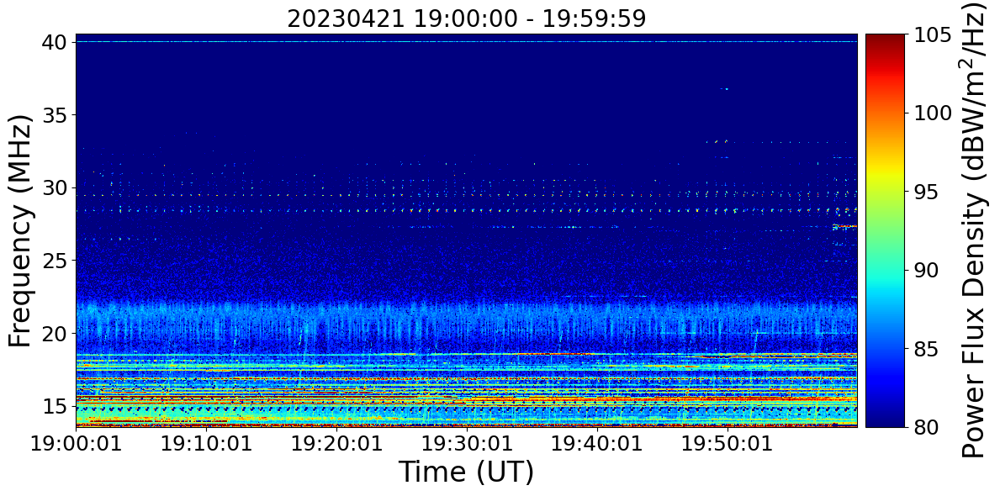



◎20:00:00 - 20:59:59


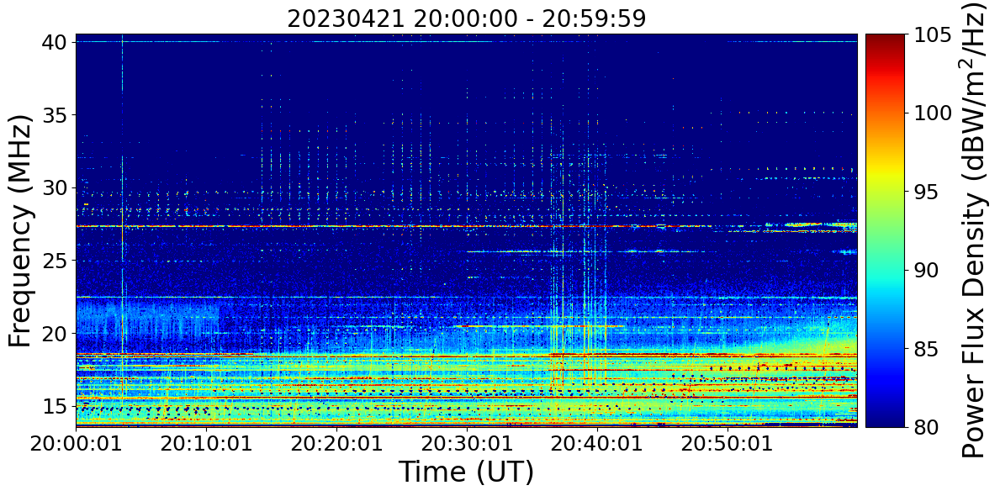



◎21:00:00 - 21:59:59


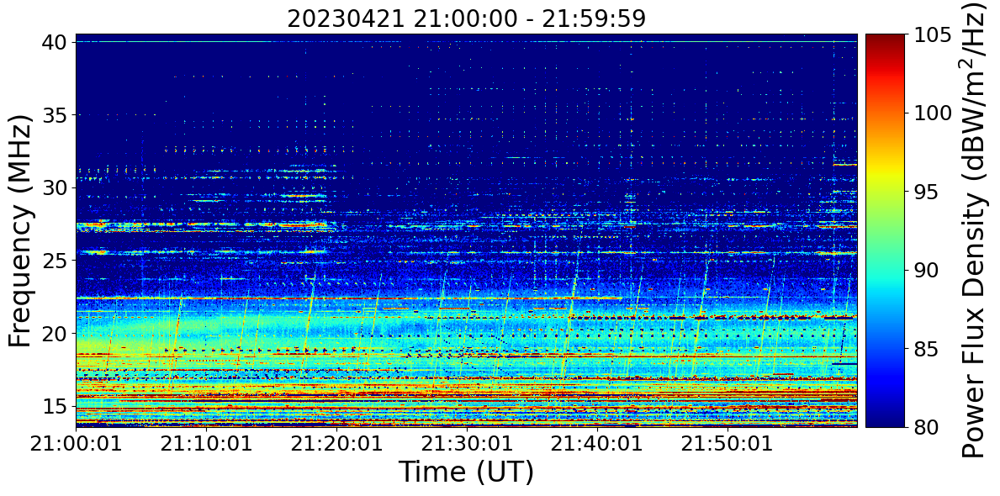



◎22:00:00 - 22:59:59


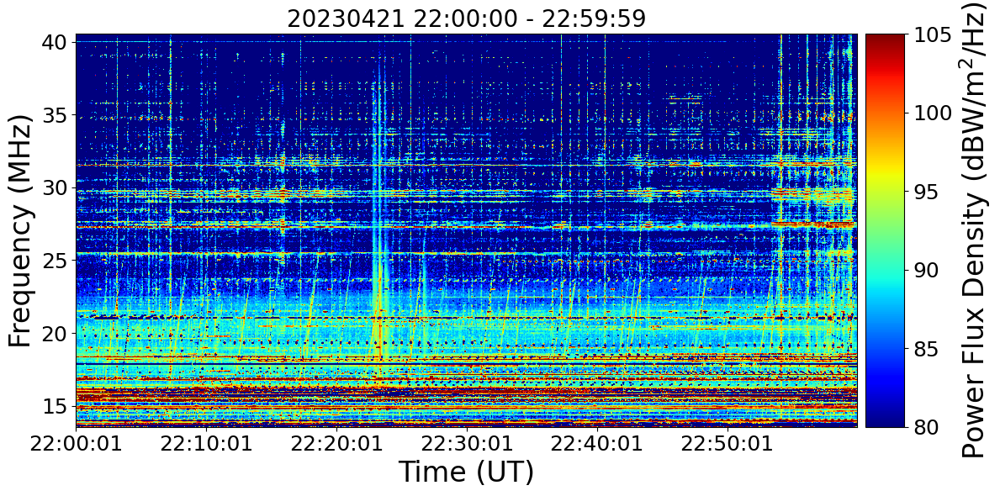



◎23:00:00 - 23:59:59


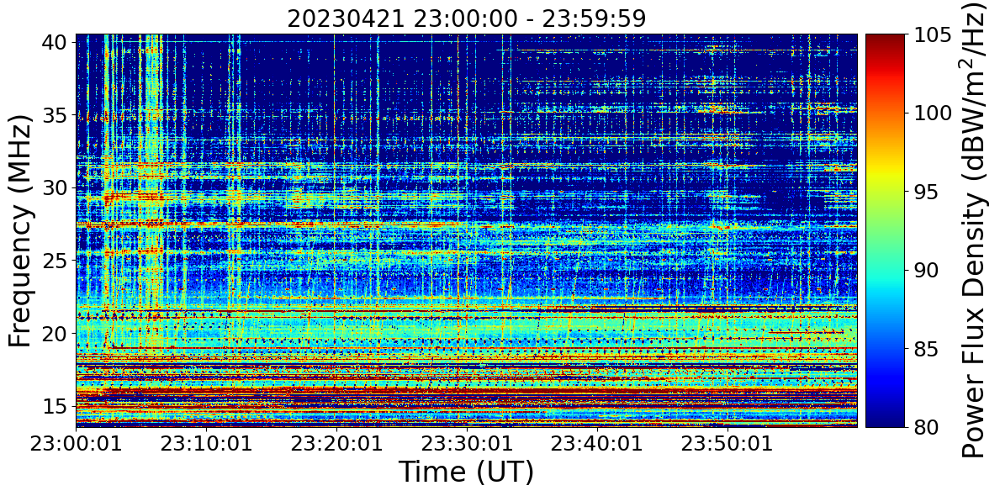

In [15]:
vmin = 80
vmax = 105
plot_all_day(year_month_date, time_interval=60*10, frequency_interval=5, div_hour=1, window_frequency_size=1, threshold_noise_max=120, threshold_noise_min=80)

### single

start_frequency =  24000000.0
end_frequency = 40000000.0



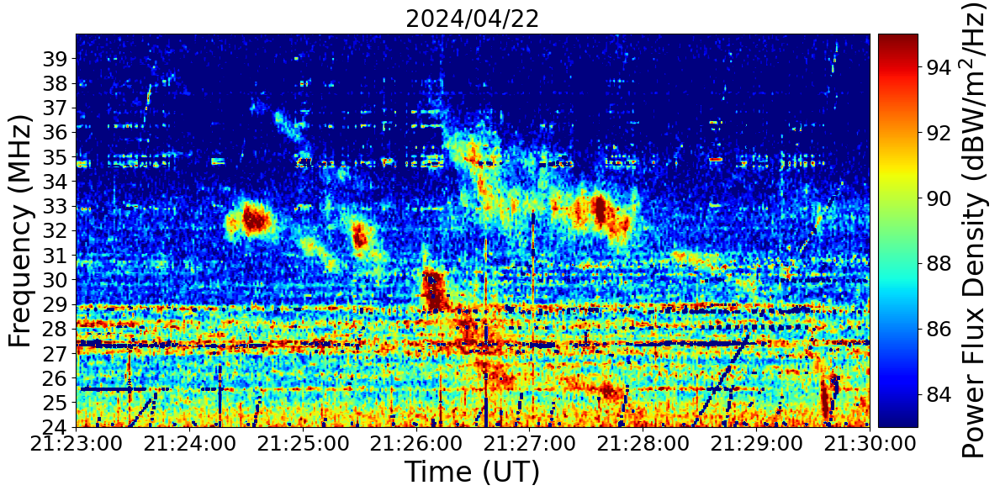

In [51]:
vmin=83
vmax=95

plot_single_lh_data(start_time=np.datetime64(f'{year}-{month:02d}-{date:02d}T21:23:00'), end_time=np.datetime64(f'{year}-{month:02d}-{date:02d}T21:30:00'), title=f'{year}/{month:02d}/{date:02d}', time_interval=60, frequency_interval=1, window_frequency_size=5, window_time_size=1, threshold_noise_max=98, threshold_noise_min=80)

In [ ]:
vmin=80
vmax=105

plot_single_lh_data(start_time=np.datetime64(f'{year}-{month:02d}-{date:02d}T21:23:00'), end_time=np.datetime64(f'{year}-{month:02d}-{date:02d}T21:30:00'), title=f'{year}/{month:02d}/{date:02d}', time_interval=60, frequency_interval=1, window_frequency_size=5, window_time_size=1, threshold_noise_max=98, threshold_noise_min=80)